# <div style="text-align: center; background-color: #595964; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">📊EDA |Earthquakes Data | Visualization | Time Series </div>

<h3 style="text-align: left;background-color: #00BFFF; font-family:Times New Roman; color: white; padding: 14px; line-height: 1; border-radius:10px"> About Dataset📁</h3>

<h4> Earthquakes Data Dataset contains <mark>12 columns</mark>, each are:</h4>

* <b> <mark>1. time in milliseconds</mark></b>
* <b> <mark>2. place</mark></b>
* <b> <mark>3. status</mark></b>
* <b> <mark>4. tsunami (boolean value)</mark></b>
* <b> <mark>5. significance</mark></b>
* <b> <mark>6. data_type</mark></b>
* <b> <mark>7. magnitude</mark></b>
* <b> <mark>8. state</mark></b>
* <b> <mark>9. longitude</mark></b>
* <b> <mark>10. latitude</mark></b>
* <b> <mark>11. depth</mark></b>
* <b> <mark>12. date</mark></b>


<a id="1"></a>
# <div style="text-align: center; background-color: #00BFFF; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">1. Import Necessary Libraries</div>

In [1]:
!pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 27.8 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.11.1
    Uninstalling scipy-1.11.1:
      Successfully uninstalled scipy-1.11.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
momepy 0.6.0 requires shapely>=2, but you have shapely 1.8.5.post1 which is incompatible.
pymc3 3.11.5 requires numpy<1.22.2,>=1.15.0, but you have numpy 1.23.5 which is incompatible.
pymc3 3.11.5 requires scipy<1.8.0,>=1.7.3, but you have scipy 1.10.1 which is incompatible.


In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import shap
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import missingno as mno
import plotly.offline as pyo 
import plotly.figure_factory as ff
import plotly.io as pio
from wordcloud import WordCloud
color_pal = sns.color_palette()
plt.style.use('seaborn-dark-palette')
plt.style.use('dark_background')

import nltk

import warnings
warnings.filterwarnings('ignore')
sns.set_theme(style='darkgrid', palette='colorblind')
from sklearn.preprocessing import LabelEncoder 
le = LabelEncoder()

#Model
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

<frozen importlib._bootstrap>:241: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
/tmp/ipykernel_21/1745313295.py:14: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



<a id="1"></a>
# <div style="text-align: center; background-color: #00BFFF; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">2. Exploratory Data Analysis 📊</div>

In [3]:
df=pd.read_csv('/kaggle/input/the-ultimate-earthquake-dataset-from-1990-2023/Eartquakes-1990-2023.csv')

In [4]:
df.head()

,time,place,status,tsunami,significance,data_type,magnitudo,state,longitude,latitude,depth,date
0,631153353990,"12 km NNW of Meadow Lakes, Alaska",reviewed,0,96,earthquake,2.50,Alaska,-149.669200,61.730200,30.100,1990-01-01 00:22:33.990000+00:00
1,631153491210,"14 km S of Volcano, Hawaii",reviewed,0,31,earthquake,1.41,Hawaii,-155.212333,19.317667,6.585,1990-01-01 00:24:51.210000+00:00
2,631154083450,"7 km W of Cobb, California",reviewed,0,19,earthquake,1.11,California,-122.806167,38.821000,3.220,1990-01-01 00:34:43.450000+00:00
3,631155512130,"11 km E of Mammoth Lakes, California",reviewed,0,15,earthquake,0.98,California,-118.846333,37.664333,-0.584,1990-01-01 00:58:32.130000+00:00
4,631155824490,"16km N of Fillmore, CA",reviewed,0,134,earthquake,2.95,California,-118.934000,34.546000,16.122,1990-01-01 01:03:44.490000+00:00


In [5]:
df.shape

(3445751, 12)

In [6]:
df.columns

Index(['time', 'place', 'status', 'tsunami', 'significance', 'data_type',
       'magnitudo', 'state', 'longitude', 'latitude', 'depth', 'date'],
      dtype='object')

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
time,3445751.0,1.247124e+12,2.976292e+11,6.311534e+11,1.024401e+12,1.282338e+12,1.508701e+12,1.690629e+12
tsunami,3445751.0,4.434447e-04,2.105346e-02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
significance,3445751.0,7.400973e+01,1.016364e+02,0.000000e+00,1.300000e+01,3.300000e+01,8.100000e+01,2.910000e+03
magnitudo,3445751.0,1.774076e+00,1.291055e+00,-9.990000e+00,9.100000e-01,1.460000e+00,2.300000e+00,9.100000e+00
longitude,3445751.0,-1.012876e+02,7.697416e+01,-1.799997e+02,-1.464274e+02,-1.189538e+02,-1.159277e+02,1.800000e+02
latitude,3445751.0,3.746483e+01,2.041577e+01,-8.442200e+01,3.406400e+01,3.793567e+01,4.784800e+01,8.738600e+01
depth,3445751.0,2.285387e+01,5.484938e+01,-1.000000e+01,3.120000e+00,7.700000e+00,1.612000e+01,7.358000e+02


In [8]:
df.describe(include = "object").T

,count,unique,top,freq
place,3445751,531130,"6 km W of Cobb, California",24202
status,3445751,6,reviewed,3224825
data_type,3445751,25,earthquake,3361846
state,3445751,858,California,866675
date,3445751,3428775,2022-03-02 23:42:23.449000+00:00,4


In [9]:
df.dtypes

time              int64
place            object
status           object
tsunami           int64
significance      int64
data_type        object
magnitudo       float64
state            object
longitude       float64
latitude        float64
depth           float64
date             object
dtype: object

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3445751 entries, 0 to 3445750
Data columns (total 12 columns):
 #   Column        Dtype  
---  ------        -----  
 0   time          int64  
 1   place         object 
 2   status        object 
 3   tsunami       int64  
 4   significance  int64  
 5   data_type     object 
 6   magnitudo     float64
 7   state         object 
 8   longitude     float64
 9   latitude      float64
 10  depth         float64
 11  date          object 
dtypes: float64(4), int64(3), object(5)
memory usage: 315.5+ MB


In [11]:
unique_values = df.nunique()
unique_values

time            3428775
place            531130
status                6
tsunami               2
significance       1170
data_type            25
magnitudo           933
state               858
longitude        733599
latitude         518295
depth             78386
date            3428775
dtype: int64

# <div style="text-align: center; background-color: #6495ED; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">3. Null values</div>

In [12]:
df.isna().sum()

time            0
place           0
status          0
tsunami         0
significance    0
data_type       0
magnitudo       0
state           0
longitude       0
latitude        0
depth           0
date            0
dtype: int64

# <div style="text-align: center; background-color: #6495ED; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">4. Duplicate rows</div>

In [13]:
# Finding duplicate rows
duplicate_rows = df[df.duplicated(keep='first')]

# Number of duplicate rows
num_duplicates = duplicate_rows.shape[0]

# Displaying the duplicate rows
print(f"Number of duplicate rows: {num_duplicates}")
duplicate_rows

Number of duplicate rows: 16869


,time,place,status,tsunami,significance,data_type,magnitudo,state,longitude,latitude,depth,date
9214,636249654650,"3 km E of Mammoth Lakes, California",reviewed,0,42,earthquake,1.66,California,-118.933667,37.647000,3.816000,1990-03-01 00:00:54.650000+00:00
9216,636249667890,"4km N of Claremont, CA",reviewed,0,70,earthquake,2.13,California,-117.717000,34.133000,4.275000,1990-03-01 00:01:07.890000+00:00
9218,636249694400,"4km N of Claremont, CA",reviewed,0,62,earthquake,2.00,California,-117.717000,34.133000,4.275000,1990-03-01 00:01:34.400000+00:00
9220,636249712400,"5km NNE of Claremont, CA",reviewed,0,22,earthquake,1.20,California,-117.705000,34.144000,5.702000,1990-03-01 00:01:52.400000+00:00
9222,636249724170,"4km N of Claremont, CA",reviewed,0,160,earthquake,3.22,California,-117.714000,34.130000,5.622000,1990-03-01 00:02:04.170000+00:00
...,...,...,...,...,...,...,...,...,...,...,...,...
3386776,1677800561550,"6km WNW of Cobb, CA",automatic,0,2,earthquake,0.36,California,-122.790169,38.834667,1.590000,2023-03-02 23:42:41.550000+00:00
3386778,1677800571801,western Texas,reviewed,0,62,earthquake,2.00,western Texas,-104.407287,31.674925,7.185596,2023-03-02 23:42:51.801000+00:00
3386780,1677800938538,"49 km N of Petersville, Alaska",reviewed,0,35,earthquake,1.50,Alaska,-150.759600,62.942400,109.700000,2023-03-02 23:48:58.538000+00:00
3386782,1677801044380,"83 km NNW of Karluk, Alaska",reviewed,0,0,earthquake,0.04,Alaska,-155.069167,58.246000,4.900000,2023-03-02 23:50:44.380000+00:00


In [14]:
# Drop duplicates rows
df.drop_duplicates(keep='first', inplace=True)

# <div style="text-align: center; background-color: #6495ED; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">5. Feature engineering</div>



In [15]:
state_counts = df['state'].value_counts()
print(state_counts.head(20))


 California          862679
 Alaska              773901
California           489003
 Nevada              173483
 Hawaii              124679
 Washington           80111
 Utah                 55168
 Montana              53167
 Indonesia            48282
 Puerto Rico          46055
 Chile                36838
 Greece               30286
 B.C.                 29883
 Japan                28800
 Oklahoma             24944
 Papua New Guinea     22912
 Italy                18539
 Philippines          17727
 Oregon               17593
 Mexico               16479
Name: state, dtype: int64


In [16]:
# Convert the 'date' column to datetime data type
df['date'] = pd.to_datetime(df['date'])

# Convert the 'time' column to time data type
df['time'] = pd.to_datetime(df['time']).dt.time

In [17]:
# Filter earthquakes with magnitudo greater than 7
filtered_magnitudo = df[df['magnitudo'] > 7]

In [18]:
# Filter earthquakes in California 
filtered_California = df[df['state'] == 'California']

In [19]:
# Filter earthquakes in Alaska 
filtered_Alaska= df[df['state'] == 'Alaska']

In [20]:
# Filter earthquakes in Nevada
filtered_Nevada = df[df['state'] == 'Nevada']

In [21]:
# Filter earthquakes in Hawaii 
filtered_Washington = df[df['state'] == 'Washington']

# <div style="text-align: center; background-color: #6495ED; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">6. Time Series</div>

In [22]:
# Calculate the sum of magnitudo for  date
magnitudo_date = filtered_magnitudo.groupby('date')['magnitudo'].sum().reset_index()

# Create a line plot using Plotly Express
# x-axis: International Student, y-axis:  date ,
# labels for the x-axis, title, and customized height
fig_magnitudo_date = px.line(
    magnitudo_date,  # DataFrame containing the data
    x='date',   # x-values: date
    y='magnitudo',  # y-values :magnitudo
    title='magnitudo by date',  # Set the title of the plot
    height=800  # Set the height of the plot
)

# Display the plot
fig_magnitudo_date.show()

# Calculate the sum of magnitudo for  date
magnitudo_date = filtered_magnitudo.groupby('time')['magnitudo'].sum().reset_index()

# Create a line plot using Plotly Express
# x-axis: International Student, y-axis:  time ,
# labels for the x-axis, title, and customized height
fig_magnitudo_date = px.line(
    magnitudo_date,  # DataFrame containing the data
    x='time',   # x-values: time
    y='magnitudo',  # y-values :magnitudo
    title='magnitudo by time',  # Set the title of the plot
    height=800  # Set the height of the plot
)

# Display the plot
fig_magnitudo_date.show()

In [23]:
# Calculate the sum of magnitudo for  date
California_data = filtered_California.groupby('date')['magnitudo'].sum().reset_index()

# Create a line plot using Plotly Express
# x-axis: International Student, y-axis:  California ,
# labels for the x-axis, title, and customized height
fig_California_data = px.line(
    California_data,  # DataFrame containing the data
    x='date',   # x-values: date
    y='magnitudo',  # y-values :magnitudo
    title='date by magnitudo',  # Set the title of the plot
    height=800  # Set the height of the plot
)

# Display the plot
fig_California_data.show()

In [24]:
# Calculate the sum of magnitudo for  date
Nevada_data = filtered_Nevada.groupby('time')['magnitudo'].sum().reset_index()

# Create a line plot using Plotly Express
# x-axis: International Student, y-axis:  date ,
# labels for the x-axis, title, and customized height
fig_Nevada_data = px.line(
    Nevada_data,  # DataFrame containing the data
    x='time',   # x-values: time
    y='magnitudo',  # y-values :magnitudo
    title='time by magnitudo',  # Set the title of the plot
    height=800  # Set the height of the plot
)

# Display the plot
fig_Nevada_data.show()

In [25]:
def transform_date(df):
    df = df.copy()
    df["hour"] = df.date.dt.hour
    df["day_of_month"] = df.date.dt.day
    df["weekday"] = df.date.dt.day_name()
    df["month"] = df.date.dt.month
    df["month_name"] = df.date.dt.month_name()
    df["year"] =df.date.dt.year
    return df

In [26]:
df = transform_date(df)

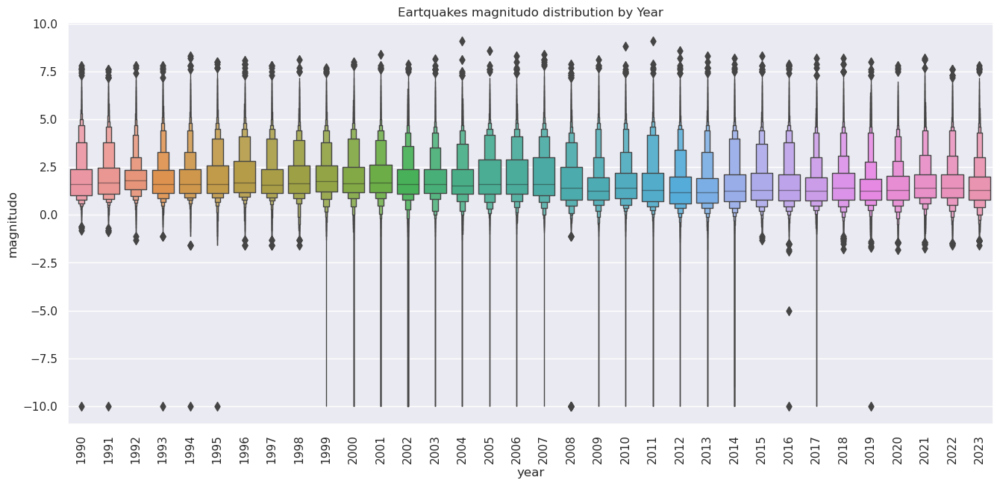

In [27]:
plt.figure(figsize=(16,7))
sns.boxenplot(df,x="year", y="magnitudo",linewidth=1 )
plt.xticks(rotation=90)
plt.title("Eartquakes magnitudo distribution by Year")
plt.show()

In [28]:
# Calculate the magnitudo by month
magnitudo_by_year = df.groupby('year')['magnitudo'].mean().reset_index()

# Create a bar plot using Plotly Express
fig = px.bar(magnitudo_by_year, x='year', y='magnitudo',
             title='magnitudo by year',
             labels={'year': 'Year'},
             template='plotly_white')

# Display the plot
fig.show()

In [29]:
# Calculate the average magnitude by year
magnitude_by_year = df.groupby('year')['magnitudo'].mean().reset_index()

# Create a line plot using Plotly Express
fig = px.line(magnitude_by_year, x='year', y='magnitudo',
              title='Average Magnitude of Earthquakes by Year',
              labels={'year': 'Year', 'magnitudo': 'Average Magnitude'},
              template='plotly_white')

# Display the plot
fig.show()

In [30]:
# Calculate the average magnitude by month
magnitude_by_month = df.groupby('month')['magnitudo'].mean().reset_index()

# Create a line plot using Plotly Express
fig = px.line(magnitude_by_month, x='month', y='magnitudo',
              title='Average Magnitude of Earthquakes by month',
              labels={'month': 'Month', 'magnitudo': 'Average Magnitude'},
              template='plotly_white')

# Display the plot
fig.show()

In [31]:
# Calculate the average magnitude by month
magnitude_by_month_name = df.groupby('month_name')['magnitudo'].mean().reset_index()

# Create a line plot using Plotly Express
fig = px.line(magnitude_by_month_name, x='month_name', y='magnitudo',
              title='Average Magnitude of Earthquakes by month',
              labels={'month_name': 'Month_name', 'magnitudo': 'Average Magnitude'},
              template='plotly_white')

# Display the plot
fig.show()

In [32]:
# Calculate the average magnitude by day_of_month
magnitude_by_day_of_month = df.groupby('day_of_month')['magnitudo'].mean().reset_index()

# Create a line plot using Plotly Express
fig = px.line(magnitude_by_day_of_month, x='day_of_month', y='magnitudo',
              title='Average Magnitude of Earthquakes by month',
              labels={'month_name': 'Month_name', 'magnitudo': 'Average Magnitude'},
              template='plotly_white')

# Display the plot
fig.show()

# <div style="text-align: center; background-color: #6495ED; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">7. Data visualisation</div>

In [33]:
# Import the ProfileReport class from the ydata_profiling library
from ydata_profiling import ProfileReport

# Create a comprehensive profile report for the DataFrame 'df'
# This report will contain various statistics, insights, and visualizations about the data
profile = ProfileReport(df)

In [34]:
profile                     # or this one
#profile.to_notebook_iframe() # use this line to show the output

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [35]:
# Calculate the value counts for each unique value in the 'place' column
top10_place = df['place'].value_counts()[:10]

# Create a bar plot using Plotly Express
# y-axis: Count of each place, x-axis: place,
# color-coded by job titles and using a color palette
fig = px.bar(
    y=top10_place.values,  # y-values: count of each place
    x=top10_place.index,   # x-values: job titles
    color=top10_place.index,  # Color the bars based on place
    color_discrete_sequence=px.colors.sequential.PuBuGn,  # Set color palette
    text=top10_place.values,  # Display the count values on top of the bars
    title='Top 10 place',  # Set the title of the plot
    template='plotly_white'  # Use a white template for the plot
)

# Update the layout of the plot
fig.update_layout(
    title_text='place Distribution',  # Set the title of the plot
    height=700,  # Set the height of the plot
    xaxis_title="place",  # Label for the x-axis
    yaxis_title="Count",  # Label for the y-axis
    font=dict(size=17, family="Franklin Gothic")  # Set the font size and family for the text
)

# Display the plot

In [36]:
# Calculate the value counts for each unique value in the 'data_type' column
top10_data_type = df['data_type'].value_counts()[:10]

# Create a bar plot using Plotly Express
# y-axis: Count of each data type, x-axis: Data types,
# color-coded by data types and using a color palette
fig = px.bar(
    y=top10_data_type.values,  # y-values: count of each data type
    x=top10_data_type.index,   # x-values: data types
    color=top10_data_type.index,  # Color the bars based on data types
    color_discrete_sequence=px.colors.sequential.PuBuGn,  # Set color palette
    text=top10_data_type.values,  # Display the count values on top of the bars
    title='Top 10 Data Types',  # Set the title of the plot
    template='plotly_white'  # Use a white template for the plot
)

# Update the layout of the plot
fig.update_layout(
    title_text='Data Type Distribution',  # Set the title of the plot
    height=700,  # Set the height of the plot
    xaxis_title="Data Type",  # Label for the x-axis
    yaxis_title="Count",  # Label for the y-axis
    font=dict(size=17, family="Franklin Gothic")  # Set the font size and family for the text
)

# Display the plot
fig.show()

In [37]:
# Calculate the value counts for each unique value in the 'status' column
top10_status = df['status'].value_counts()[:6]

# Create a bar plot using Plotly Express
# y-axis: Count of each status, x-axis: Statuses,
# color-coded by statuses and using a color palette
fig = px.bar(
    y=top10_status.values,  # y-values: count of each status
    x=top10_status.index,   # x-values: statuses
    color=top10_status.index,  # Color the bars based on statuses
    color_discrete_sequence=px.colors.sequential.PuBuGn,  # Set color palette
    text=top10_status.values,  # Display the count values on top of the bars
    title='Top 10 Statuses',  # Set the title of the plot
    template='plotly_white'  # Use a white template for the plot
)

# Update the layout of the plot
fig.update_layout(
    title_text='Status Distribution',  # Set the title of the plot
    height=700,  # Set the height of the plot
    xaxis_title="Status",  # Label for the x-axis
    yaxis_title="Count",  # Label for the y-axis
    font=dict(size=17, family="Franklin Gothic")  # Set the font size and family for the text
)

# Display the plot
fig.show()

In [38]:
# Calculate the value counts for each unique value in the 'state' column
top10_states = df['state'].value_counts()[:10]

# Create a bar plot using Plotly Express
# y-axis: Count of each state, x-axis: States,
# color-coded by states and using a color palette
fig = px.bar(
    y=top10_states.values,  # y-values: count of each state
    x=top10_states.index,   # x-values: states
    color=top10_states.index,  # Color the bars based on states
    color_discrete_sequence=px.colors.sequential.PuBuGn,  # Set color palette
    text=top10_states.values,  # Display the count values on top of the bars
    title='Top 10 States with Highest Occurrences',  # Set the title of the plot
    template='plotly_white'  # Use a white template for the plot
)

# Update the layout of the plot
fig.update_layout(
    title_text='Distribution of Earthquake Occurrences by State',  # Set the title of the plot
    height=700,  # Set the height of the plot
    xaxis_title="State",  # Label for the x-axis
    yaxis_title="Count",  # Label for the y-axis
    font=dict(size=17, family="Franklin Gothic")  # Set the font size and family for the text
)

# Display the plot
fig.show()

In [39]:
# Calculate the value counts for each unique value in the 'year' column
year_counts = df['year'].value_counts()

# Sort the years in ascending order
sorted_years = year_counts.sort_index()

# Create a bar plot using Plotly Express
fig = px.bar(
    x=sorted_years.index,   # x-values: years
    y=sorted_years.values,  # y-values: count of occurrences
    color=sorted_years.index,  # Color the bars based on years
    color_discrete_sequence=px.colors.sequential.PuBuGn,  # Set color palette
    text=sorted_years.values,  # Display the count values on top of the bars
    title='Earthquake Occurrences by Year',  # Set the title of the plot
    template='plotly_dark'  # Use a dark template for the plot
)

# Update the layout of the plot
fig.update_layout(
    title_text='Distribution of Earthquake Occurrences by Year',  # Set the title of the plot
    height=700,  # Set the height of the plot
    xaxis_title="Year",  # Label for the x-axis
    yaxis_title="Count",  # Label for the y-axis
    font=dict(size=17, family="Franklin Gothic")  # Set the font size and family for the text
)

# Display the plot
fig.show()

In [40]:

# Calculate the value counts for each unique value in the 'month_name' column
month_counts = df['month_name'].value_counts()

# Create a bar plot using Plotly Express
fig = px.bar(
    x=month_counts.index,   # x-values: month names
    y=month_counts.values,  # y-values: count of occurrences
    color=month_counts.index,  # Color the bars based on month names
    color_discrete_sequence=px.colors.sequential.PuBuGn,  # Set color palette
    text=month_counts.values,  # Display the count values on top of the bars
    title='Earthquake Occurrences by Month',  # Set the title of the plot
    template='plotly_dark'  # Use a dark template for the plot
)

# Update the layout of the plot
fig.update_layout(
    title_text='Distribution of Earthquake Occurrences by Month',  # Set the title of the plot
    height=700,  # Set the height of the plot
    xaxis_title="Month",  # Label for the x-axis
    yaxis_title="Count",  # Label for the y-axis
    font=dict(size=17, family="Franklin Gothic")  # Set the font size and family for the text
)

# Display the plot
fig.show()

In [41]:
# Select the top 10 magnitudes in the DataFrame
top10_magnitudes = df['magnitudo'].sort_values(ascending=False).head(10)

# Create a bar plot using Plotly Express
# y-axis: Magnitude values, x-axis: Index of the top 10 magnitudes,
# color-coded by the index, and using a color palette
fig = px.bar(
    y=top10_magnitudes.values,  # y-values: top 10 magnitudes
    x=top10_magnitudes.index,   # x-values: indices of the top 10 magnitudes
    color=top10_magnitudes.index,  # Color the bars based on the indices
    color_discrete_sequence=px.colors.sequential.PuBuGn,  # Set color palette
    text=top10_magnitudes.values,  # Display the magnitude values on top of the bars
    title='Top 10 Magnitudes',  # Set the title of the plot
    template='plotly_dark'  # Use a dark template for the plot
)

# Update the layout of the plot
fig.update_layout(
    title_text='Magnitude Distribution',  # Set the title of the plot
    height=700,  # Set the height of the plot
    xaxis_title="Index",  # Label for the x-axis
    yaxis_title="Magnitude",  # Label for the y-axis
    font=dict(size=17, family="Franklin Gothic")  # Set the font size and family for the text
)

# Display the plot
fig.show()


In [42]:
# Calculate the average magnitudo for each place and sort in descending order
average_magnitudo = df.groupby('place')['magnitudo'].mean().reset_index()
average_magnitudo = average_magnitudo.sort_values(by='magnitudo', ascending=False)

# Select the top 20 places with the highest average magnitudo
top_10_magnitudo = average_magnitudo.head(20)

# Create a new figure using Plotly
fig = go.Figure()

# Add a bar trace to the figure
fig.add_trace(go.Bar(
    x=top_10_magnitudo['place'],  # x-values: place
    y=top_10_magnitudo['magnitudo'],  # y-values: average magnitudo
    marker_color='#6495ED'  # Set the color of the bars
))

# Update the layout and appearance of the plot
fig.update_layout(
    title='Top 20 Places by Average Magnitude',  # Set the title of the plot
    xaxis_title='Place',  # Label for the x-axis
    yaxis_title='Average Magnitude',  # Label for the y-axis
    template='plotly_white',  # Use a white template for the plot
    font=dict(color='black'),  # Set font color to black
    height=800  # Set the height of the plot
)

# Initialize Plotly for notebook integration
pyo.init_notebook_mode(connected=True)

# Display the plot
pyo.iplot(fig)


In [43]:
# Calculate the average magnitude for each state and sort in descending order
average_magnitudo = df.groupby('state')['magnitudo'].mean().reset_index()
average_magnitudo = average_magnitudo.sort_values(by='magnitudo', ascending=False)

# Select the top 20 states with the highest average magnitude
top_20_magnitudo = average_magnitudo.head(20)

# Create a new figure using Plotly
fig = go.Figure()

# Add a bar trace to the figure
fig.add_trace(go.Bar(
    x=top_20_magnitudo['state'],  # x-values: state
    y=top_20_magnitudo['magnitudo'],  # y-values: average magnitudo
    marker_color='#6495ED'  # Set the color of the bars
))

# Update the layout and appearance of the plot
fig.update_layout(
    title='Top 20 States by Average Magnitude',  # Set the title of the plot
    xaxis_title='State',  # Label for the x-axis
    yaxis_title='Average Magnitude',  # Label for the y-axis
    template='plotly_white',  # Use a white template for the plot
    font=dict(color='black'),  # Set font color to black
    height=800  # Set the height of the plot
)

# Initialize Plotly for notebook integration
pyo.init_notebook_mode(connected=True)

# Display the plot
pyo.iplot(fig)


In [44]:
def plot_strongest(df):
    gb_top = df.groupby(["state"])\
               .agg({"significance":"max", "magnitudo":"max"})\
               .reset_index()

    b = df[["year", "state","significance","longitude", "latitude","magnitudo"]]
    merge = pd.merge(gb_top, b, how = "left", on =["state","significance", "magnitudo"]).sort_values(by="year")


    fig = px.scatter_geo(merge, 
                         lat="latitude", lon="longitude", 
                         size="significance",
                         animation_frame="year",
                         projection="natural earth",
                         title = "Strongest eartquake by year" ,
                         template='plotly_dark'  # Use a dark template for the plot
)
    fig.show()
    
plot_strongest(df)

In [45]:
def Freq_df(cleanwordlist):
    Freq_dist_nltk = nltk.FreqDist(cleanwordlist)
    df_freq = pd.DataFrame.from_dict(Freq_dist_nltk, orient='index')
    df_freq.columns = ['Frequency']
    df_freq.index.name = 'Term'
    df_freq = df_freq.sort_values(by=['Frequency'],ascending=False)
    df_freq = df_freq.reset_index()
    return df_freq

def Word_Cloud(data, color_background, colormap, title):
    plt.figure(figsize = (20,15))
    wc = WordCloud(width=1200, 
               height=600, 
               max_words=50,
               colormap= colormap,
               max_font_size = 100,
               random_state=88, 
               background_color=color_background).generate_from_frequencies(data)
    plt.imshow(wc, interpolation='bilinear')
    plt.title(title, fontsize=20)
    plt.axis('off')
    plt.show()

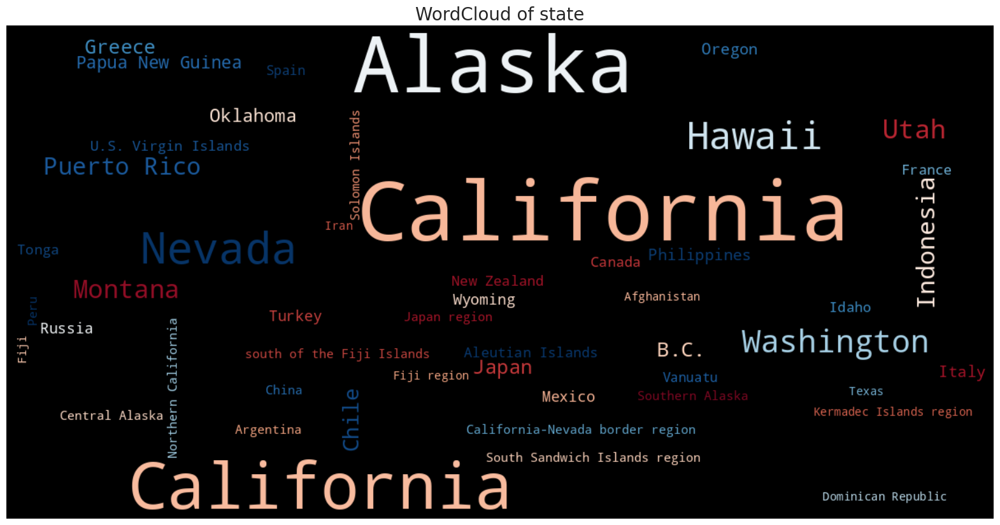

In [46]:
freq_df = Freq_df(df['state'].values.tolist())
data = dict(zip(freq_df['Term'].tolist(), freq_df['Frequency'].tolist()))
data = freq_df.set_index('Term').to_dict()['Frequency']

Word_Cloud(data ,'black','RdBu', 'WordCloud of state')

# <div style="text-align: center; background-color: #6495ED; font-family:Times New Roman; color: white; padding: 14px; line-height: 1;border-radius:20px">7. Categorical

</div>

In [47]:
# Select columns with object (categorical) data types
num_cols = df.select_dtypes(include='object').columns.tolist()

# Initialize the LabelEncoder
le = LabelEncoder()

# Apply Label Encoding to the selected numerical columns
for x in num_cols:  
    df[x] = le.fit_transform(df[x])

# Now, your categorical columns (excluding column 0) have been converted to numerical values

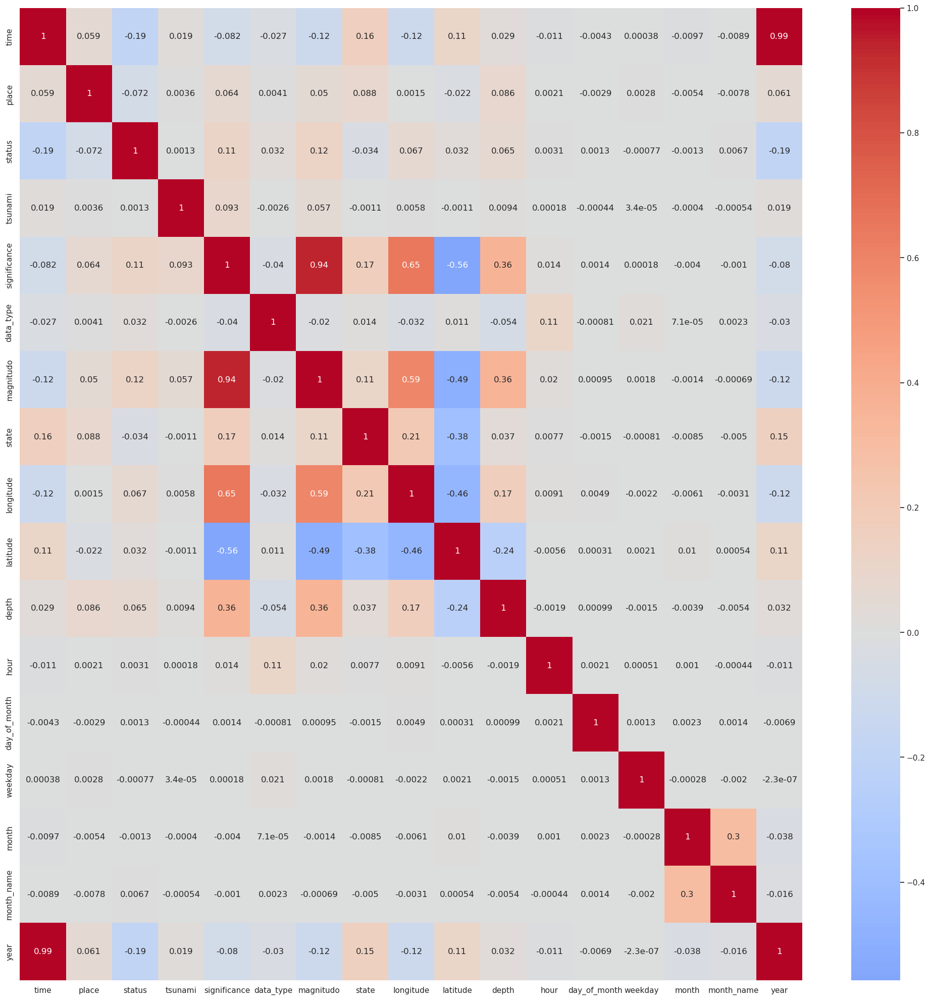

In [48]:
Corr_Matrix = df.corr()

# Set up the figure and plot the heatmap
plt.figure(figsize=(25,25))
sns.heatmap(Corr_Matrix, annot=True, cmap='coolwarm', center=0)
plt.show()

In [49]:
print('Top 5 Most Positively Correlated to the To Price')
Corr_Matrix['magnitudo'].sort_values(ascending=False).head(5)

Top 5 Most Positively Correlated to the To Price


magnitudo       1.000000
significance    0.939363
longitude       0.590907
depth           0.356965
status          0.123914
Name: magnitudo, dtype: float64

In [50]:
print('Top 5 Most Negatively Correlated to Price ')
Corr_Matrix['magnitudo'].sort_values(ascending=True).head(5)

Top 5 Most Negatively Correlated to Price 


latitude    -0.494314
year        -0.119182
time        -0.118382
data_type   -0.019740
month       -0.001425
Name: magnitudo, dtype: float64